# Project Loading Example

_This notebook uses a dataset of videos stored as a tensor flow datasets._

In [ ]:
from google.colab import drive
drive.mount('/content/drive', force_remount=True)

Mounted at /content/drive


# Setup

## 1.Reading Data

First, let's make sure we have the proper version installed. This notebook works in python 3. Import a few common modules.

In [ ]:
from pkg_resources import parse_version

# Python ≥3.5 is required
import sys
assert sys.version_info >= (3,5)

# Tensorflow ≥2.0 is required

# Common imports
import numpy as np
import os

# to make this notebook's output stable across runs
def reset_seed(seed=42):
    np.random.seed(seed)

# To plot pretty figures - source Aurelien Geron
import matplotlib
import matplotlib.pyplot as plt
plt.rcParams['axes.labelsize'] = 14
plt.rcParams['xtick.labelsize'] = 12
plt.rcParams['ytick.labelsize'] = 12

# Where to save the figures
# Based on post by GM at https://stackoverflow.com/questions/53581278
if 'google.colab' in str(get_ipython()):
  print('Running on CoLab')
  from google.colab import drive
  # mount your google drive into colab
  # this is interactive unfortunately
  # must paste authorization code on prompt
  drive.mount('/content/drive')
  PROJECT_ROOT_DIR = "drive/MyDrive/CV"
else:
  print('Not running on CoLab')
  PROJECT_ROOT_DIR = os.getcwd()

NB_ID = "project"

# create the directory if it does not exist
IMAGE_DIR = os.path.join(PROJECT_ROOT_DIR, "images", NB_ID)
os.makedirs(IMAGE_DIR, exist_ok = True)

def save_fig_nb(fig_id, tight_layout=True):
    path = os.path.join(IMAGE_DIR, fig_id + ".png")
    print("Saving figure", fig_id)
    if tight_layout:
        plt.tight_layout()
    plt.savefig(path, format='png', dpi=300)

os.makedirs(os.path.join(PROJECT_ROOT_DIR,"tb_logs",NB_ID), exist_ok = True)

def get_logdir(add=''):
    import time
    log_id = time.strftime("log_%Y_%m_%d-%H_%M_%S")
    return os.path.join(PROJECT_ROOT_DIR,"tb_logs",NB_ID,log_id+add)

Running on CoLab
Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


A couple utility functions to plot grayscale and RGB images (source Aurelien Geron):

In [ ]:
def plot_image(image):
    plt.imshow(image, cmap="gray", interpolation="nearest")
    plt.axis("off")

def plot_color_image(image):
    plt.imshow(image.astype(np.uint8),interpolation="nearest")
    plt.axis("off")

### 1.1.Loading TensorFlow and check for GPU

In [ ]:
import os
import tensorflow as tf
import tensorflow_datasets as tfds

# For some reason we seem to need to load tf onto the GPU first
dummy = tf.constant( 32 )
print("Num GPUs Available: ", len(tf.config.experimental.list_physical_devices('GPU')))

Num GPUs Available:  1


### 1.2.Data Loading

The dataset is packaged as a Tensorflow dataset in three sub categories.


In [ ]:
tfds.disable_progress_bar()

print(PROJECT_ROOT_DIR)

data_path = os.path.join(PROJECT_ROOT_DIR)
os.makedirs(data_path, exist_ok = True)

print("Using directory: ", data_path)

flow_data_set1 = tfds.load('elg7186_projectdata/linear_movement_rotate', data_dir=data_path)
flow_data_set2 = tfds.load('elg7186_projectdata/rotation_rotate', data_dir=data_path)
flow_data_set3 = tfds.load('elg7186_projectdata/fixed_random_rotate', data_dir=data_path)
# /content/drive/MyDrive/CV/elg7186_projectdata
# Set up an iterator over the data
# iter_data = iter(flow_data_set['train'])
# Get the first video
# train_data = next(iter_data)


drive/MyDrive/CV
Using directory:  drive/MyDrive/CV


### 1.2.Video Metadata Extraction

In [ ]:
import tensorflow as tf
import tensorflow_datasets as tfds
import matplotlib.pyplot as plt
import cv2
import numpy as np

# Set the path to the data directory
data_path = os.path.join(PROJECT_ROOT_DIR)

# Load the video dataset
flow_data_set1 = tfds.load('elg7186_projectdata/linear_movement_rotate', data_dir=data_path)

# Get all videos from the dataset
videos_data = flow_data_set1["train"]

# Get video metadata
metadata_iterator = iter(videos_data.take(1).map(lambda x: x["metadata"]))
metadata = next(metadata_iterator)
width, height = metadata["width"], metadata["height"]
num_frames = metadata["num_frames"]

# Convert frames to a format compatible with OpenCV (uint8)
videos = tfds.as_numpy(videos_data.map(lambda x: x["video"]))

# Create a directory to save the videos
output_dir = "/content/drive/MyDrive/CV/output_videos"
os.makedirs(output_dir, exist_ok=True)

# Iterate through all videos
for video_index, video_frames in enumerate(videos):
    # Save the frames as a video file
    video_filename = os.path.join(output_dir, f"video_{video_index}.mp4")
    video_writer = cv2.VideoWriter(video_filename, cv2.VideoWriter_fourcc(*'mp4v'), 30, (256, 256))  # Note the height and width reversal

    for frame in video_frames:
        video_writer.write(cv2.cvtColor(frame, cv2.COLOR_RGB2BGR))

    video_writer.release()


## 2.Data Preparation

In [ ]:
iter_data1 = iter(flow_data_set1['train'])
iter_data2 = iter(flow_data_set2['train'])
iter_data3 = iter(flow_data_set3['train'])

all_videos = []
try:
    while True:
        video = next(iter_data1)
        all_videos.append(video)
except StopIteration:
    pass
try:
    while True:
        video = next(iter_data2)
        all_videos.append(video)
except StopIteration:
    pass
try:
    while True:
        video = next(iter_data3)
        all_videos.append(video)
except StopIteration:
    pass

### 2.1.Collect Specific Object with its boundary

1.   Initialize and Setting Image Directory
2.   Specify Target Object
3.   Bounding Box Extraction
4.   Display Processed Image
5.   Convert to DataFrame and Save



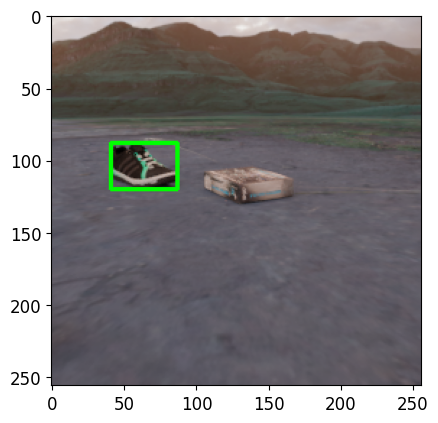

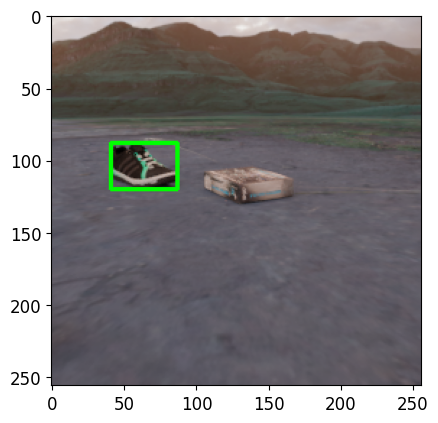

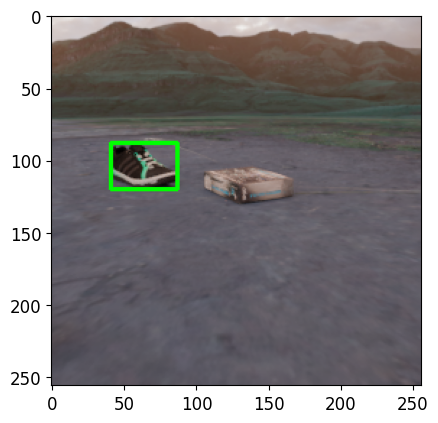

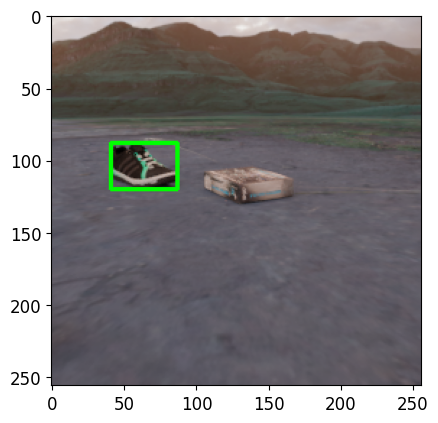

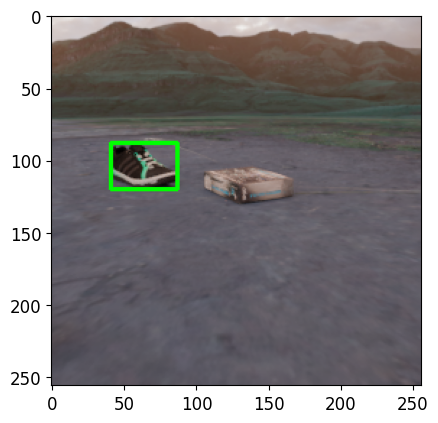

...

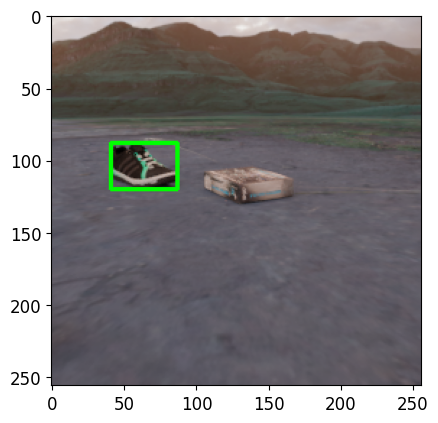

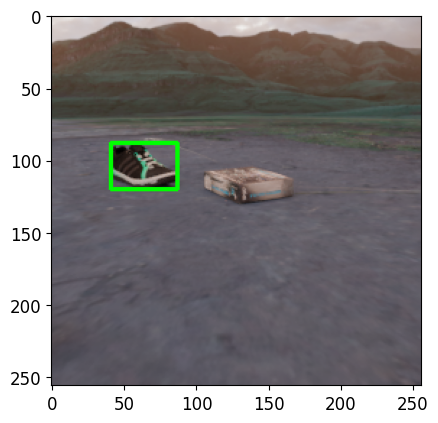

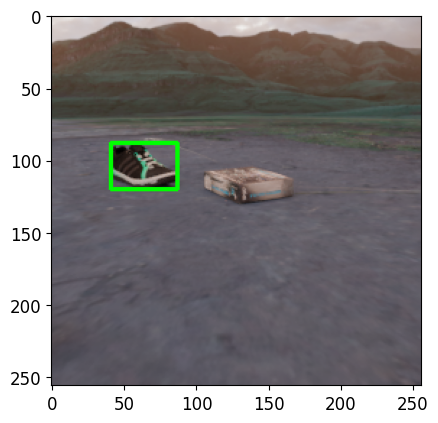

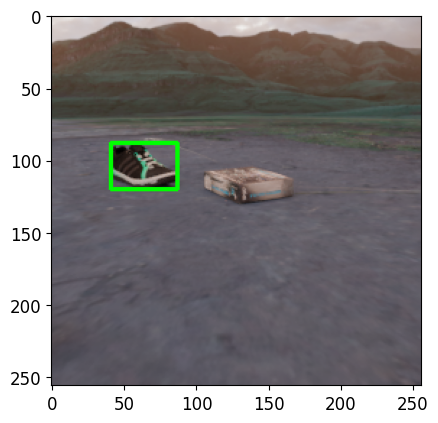

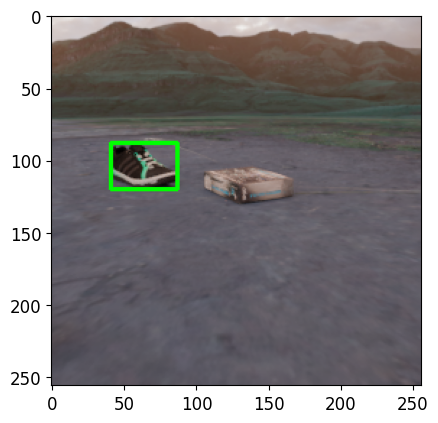

KeyboardInterrupt: ignored

In [ ]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import tensorflow as tf
import tensorflow_datasets as tfds
import os
import cv2
def find_index(input, id):
    for i in range(len(input)):
        if input[i] == id:
            return i
    return -1
# Initialize lists to store the images, bounding boxes, image paths, and class names
images_list1 = []
image_paths_list = []
bboxes_list1 = []
video_class_name = []

# Define the directory to save the images
image_dir = 'image_data'
os.makedirs(image_dir, exist_ok=True)

# Choose the specific object based on its 'asset_id'
target_asset_id = 14

for i, train_data in enumerate(all_videos):
    num_frames = int(train_data['metadata']['num_frames'])
    resolution = [train_data['metadata']['height'], train_data['metadata']['width']]

    for i in range(num_frames):
        # Initialize list to store the bounding boxes for this frame
        frame_bboxes1 = []
        frame_class_name = []

        for id in range(train_data['instances']['bbox_frames'].shape[0]):

            if train_data['instances']['category'][id].numpy() == target_asset_id:
                if i in train_data['instances']['bbox_frames'][id]:
                    frame_class_name.append(0)
                    t = find_index(train_data['instances']['bbox_frames'][id], i)
                    item = train_data['instances']['bboxes'][id, t, :]
                    y_min = int(item[0] * float(resolution[0]))
                    x_min = int(item[1] * float(resolution[1]))
                    y_max = int(item[2] * float(resolution[0]))
                    x_max = int(item[3] * float(resolution[1]))

                    # Append the bounding box to the list
                    frame_bboxes1.append([x_min, y_min, x_max, y_max])

                    # Save the image to disk
                    image = train_data['video'][i, :, :, :].numpy()

                    # cv2.rectangle(image, (x_min, y_min), (x_max, y_max), (0, 255, 0), 2)
                    # plt.imshow(cv2.cvtColor(image, cv2.COLOR_BGR2RGB))

                    image_path = os.path.join(image_dir, f'frame_{i}_cls_{0}.jpg')
                    cv2.imwrite(image_path, image)
                    image_paths_list.append(image_path)
                    images_list1.append(image)
                    bboxes_list1.append(frame_bboxes1)
                    video_class_name.append(frame_class_name)
                    # plt.show()

        cv2.rectangle(image, (x_min, y_min), (x_max, y_max), (0, 255, 0), 2)
        plt.imshow(cv2.cvtColor(image, cv2.COLOR_BGR2RGB))
        plt.show()
        # Append the image and the list of bounding boxes for this frame to the main lists

# Convert the lists to a DataFrame
df1 = pd.DataFrame({
    'image': images_list1,
    'image_path': image_paths_list,
    'bounding_boxes': bboxes_list1,
    'class': video_class_name
})

# Save the DataFrame to a CSV file
df1.to_csv('your_dataframe_with_image_paths.csv', index=False)


Showing Header to maked sure all correct

In [ ]:
df1.head(1)

,image,image_path,bounding_boxes,class
0,"[[[236, 232, 230], [234, 231, 228], [229, 226,...",image_data/frame_0_cls_0.jpg,"[[126, 97, 193, 126], [69, 85, 111, 120]]","[0, 0]"


### 2.2.Data Preparation for YOLO Model


1.   Normalize Bounding Box Coordinates and dataframe
2.   Split Data into Training and Validation Sets



In [ ]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from sklearn.model_selection import train_test_split
# Define the class label for the target instance
class_label = 0  # You can assign a unique integer for your target class

# Define YOLO model input size (width and height)
model_input_size = (256, 256)  # Adjust according to your YOLO model's input size
yolo_data_df=df1.copy()
# Define the function to normalize bounding box coordinates
def normalize_bbox(box, image_shape):
    x_min, y_min, x_max, y_max = box
    x_center = (x_min + x_max) / (2 * image_shape[1])
    y_center = (y_min + y_max) / (2 * image_shape[0])
    width = (x_max - x_min) / image_shape[1]
    height = (y_max - y_min) / image_shape[0]
    return x_center, y_center, width, height

# Normalize bounding box coordinates for YOLO format
yolo_data_df['bounding_boxes'] = yolo_data_df['bounding_boxes'].apply(lambda boxes: [normalize_bbox(box, model_input_size) for box in boxes])

# Rename the 'bounding_boxes' column to 'bbox' to match YOLO terminology
yolo_data_df.rename(columns={'bounding_boxes': 'bbox'}, inplace=True)

# Create a list of image file paths to use for YOLO training
# You should save your images to disk and update this list accordingly
# Example: image_file_paths = ['path/to/image1.jpg', 'path/to/image2.jpg', ...]
# image_file_paths = ['path/to/image1.jpg', 'path/to/image2.jpg', ...]

# Add the 'image_file' column to the DataFrame
# yolo_data_df['image_file'] = image_file_paths

# Split the data into training and validation sets
validation_split = 0.2  # Fraction of data to use for validation
train_data, test_data = train_test_split(yolo_data_df, test_size=validation_split, random_state=42)
train_data, val_data = train_test_split(train_data, test_size=validation_split, random_state=42)

# Save the train and validation sets to separate CSV files
# train_data.to_csv('yolo_train_data.csv', index=False)
# val_data.to_csv('yolo_val_data.csv', index=False)

---------------

### 2.3.Saving Images and Labels into training, valdidation and testing sets for YOLO Training then Iterate Through DataFrame and Save Files

In [ ]:
import os
import cv2
import pandas as pd

# Define the root directory
root_directory = '/content'
images_directory = os.path.join(root_directory, 'images/train')
labels_directory = os.path.join(root_directory, 'labels/train')

# Create the 'images' and 'labels' directories
os.makedirs(images_directory, exist_ok=True)
os.makedirs(labels_directory, exist_ok=True)

# Iterate through the train_data DataFrame
for index, row in train_data.iterrows():
    image_path = os.path.join(images_directory, f'image{index}.jpg')
    label_path = os.path.join(labels_directory, f'image{index}.txt')

    # Save the image
    image = row['image']
    cv2.imwrite(image_path, image)

    # Save the label file
    with open(label_path, 'w') as label_file:
        for bbox, class_name in zip(row['bbox'], row['class']):
            # Convert bounding box coordinates and format as YOLO
            x, y, w, h = bbox
            label_file.write(f'{class_name} {x} {y} {w} {h}\n')

# Repeat the process for val_data if needed


In [ ]:
import os
import cv2
import pandas as pd

# Define the root directory
root_directory = '/content'
images_directory = os.path.join(root_directory, 'images/val')
labels_directory = os.path.join(root_directory, 'labels/val')

# Create the 'images' and 'labels' directories
os.makedirs(images_directory, exist_ok=True)
os.makedirs(labels_directory, exist_ok=True)

# Iterate through the train_data DataFrame
for index, row in val_data.iterrows():
    image_path = os.path.join(images_directory, f'image{index}.jpg')
    label_path = os.path.join(labels_directory, f'image{index}.txt')

    # Save the image
    image = row['image']
    cv2.imwrite(image_path, image)

    # Save the label file
    with open(label_path, 'w') as label_file:
        for bbox, class_name in zip(row['bbox'], row['class']):
            # Convert bounding box coordinates and format as YOLO
            x, y, w, h = bbox
            label_file.write(f'{class_name} {x} {y} {w} {h}\n')

# Repeat the process for val_data if needed


In [ ]:
import os
import cv2
import pandas as pd

# Define the root directory
root_directory = '/content'
images_directory = os.path.join(root_directory, 'images/test')
labels_directory = os.path.join(root_directory, 'labels/test')

# Create the 'images' and 'labels' directories
os.makedirs(images_directory, exist_ok=True)
os.makedirs(labels_directory, exist_ok=True)

# Iterate through the train_data DataFrame
for index, row in val_data.iterrows():
    image_path = os.path.join(images_directory, f'image{index}.jpg')
    label_path = os.path.join(labels_directory, f'image{index}.txt')

    # Save the image
    image = row['image']
    cv2.imwrite(image_path, image)

    # Save the label file
    with open(label_path, 'w') as label_file:
        for bbox, class_name in zip(row['bbox'], row['class']):
            # Convert bounding box coordinates and format as YOLO
            x, y, w, h = bbox
            label_file.write(f'{class_name} {x} {y} {w} {h}\n')

# Repeat the process for val_data if needed


### 2.4.Make data config file to train yolo 

    

In [ ]:
import yaml

# Define your configuration parameters as a Python dictionary
config = {
    "train": "/content/drive/MyDrive/images/train",
    "val": "/content/drive/MyDrive/images/val",
    # "test": "/content/drive/MyDrive/imagestest",

    'train_labels': '/content/drive/MyDrive/labels/train',
    'val_labels': '/content/drive/MyDrive/labels/val',
    # 'test_labels': '/content/labels/test',

    "nc": 1,  # Number of classes
    'names': {0: 'shoe'},
    "batch-size": 16,
    "subdivisions": 4,
    "width": 256,
    "height": 256,
    "channels": 3,
    "momentum": 0.949,
    "decay": 0.0005,
    "angle": 0,
    "saturation": 1.5,
    "exposure": 1.5,
    "hue": 0.1,
    "learning-rate": 0.001,
    "burn-in": 1000,
    "max-batches": 500500,
    "policy": "steps",
    "steps": "400000,450000",
    "scales": "0.1,0.1",
    "letter-box": 0
}

# Save the configuration to a YAML file
with open("your_yolo_config.yaml", "w") as yaml_file:
    yaml.dump(config, yaml_file)


In [ ]:
import yaml

# Define your configuration parameters as a Python dictionary
config = {
    # "": "/content/images/train",
    "train": "/content/drive/MyDrive/images/val",
    "val": "/content/drive/MyDrive/images/test",

    # 'train_labels': '/content/labels/train',
    'train_labels': '/content/drive/MyDrive/labels/val',
    'val_labels': '/content/drive/MyDrive/labels/test',

    "nc": 1,  # Number of classes
    'names': {0: 'shoe'},
    "batch-size": 16,
    "subdivisions": 4,
    "width": 256,
    "height": 256,
    "channels": 3,
    "momentum": 0.949,
    "decay": 0.0005,
    "angle": 0,
    "saturation": 1.5,
    "exposure": 1.5,
    "hue": 0.1,
    "learning-rate": 0.001,
    "burn-in": 1000,
    "max-batches": 500500,
    "policy": "steps",
    "steps": "400000,450000",
    "scales": "0.1,0.1",
    "letter-box": 0
}

# Save the configuration to a YAML file
with open("your_yolo_config1.yaml", "w") as yaml_file:
    yaml.dump(config, yaml_file)


## 3.Modelling object Detection

### 3.1.Train Yolov8 on our custom data

In [ ]:
!pip install ultralytics


     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 645.8/645.8 kB 9.4 MB/s eta 0:00:00


In [ ]:
# Load YOLOv8n, train it on COCO128 for 3 epochs and predict an image with it
from ultralytics import YOLO

model = YOLO('yolov8n.pt')  # load a pretrained YOLOv8n detection model
model.train(data='/content/your_yolo_config.yaml', epochs=40)  # train the model


Ultralytics YOLOv8.0.215 🚀 Python-3.10.12 torch-2.1.0+cu118 CUDA:0 (Tesla T4, 15102MiB)
engine/trainer: task=detect, mode=train, model=yolov8n.pt, data=/content/your_yolo_config.yaml, epochs=40, patience=50, batch=16, imgsz=640, save=True, save_period=-1, cache=False, device=None, workers=8, project=None, name=train2, exist_ok=False, pretrained=True, optimizer=auto, verbose=True, seed=0, deterministic=True, single_cls=False, rect=False, cos_lr=False, close_mosaic=10, resume=False, amp=True, fraction=1.0, profile=False, freeze=None, overlap_mask=True, mask_ratio=4, dropout=0.0, val=True, split=val, save_json=False, save_hybrid=False, conf=None, iou=0.7, max_det=300, half=False, dnn=False, plots=True, source=None, show=False, save_txt=False, save_conf=False, save_crop=False, show_labels=True, show_conf=True, vid_stride=1, stream_buffer=False, line_width=None, visualize=False, augment=False, agnostic_nms=False, classes=None, retina_masks=False, boxes=True, format=torchscript, keras=False,

train: Scanning /content/drive/MyDrive/labels/train... 1350 images, 0 backgrounds, 0 corrupt: 100%|██████████| 1350/1350 [01:41<00:00, 13.31it/s]


train: New cache created: /content/drive/MyDrive/labels/train.cache
albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01), CLAHE(p=0.01, clip_limit=(1, 4.0), tile_grid_size=(8, 8))


val: Scanning /content/drive/MyDrive/labels/val... 338 images, 0 backgrounds, 0 corrupt: 100%|██████████| 338/338 [00:22<00:00, 15.32it/s]


val: New cache created: /content/drive/MyDrive/labels/val.cache
Plotting labels to runs/detect/train2/labels.jpg... 
optimizer: 'optimizer=auto' found, ignoring 'lr0=0.01' and 'momentum=0.937' and determining best 'optimizer', 'lr0' and 'momentum' automatically... 
optimizer: AdamW(lr=0.002, momentum=0.9) with parameter groups 57 weight(decay=0.0), 64 weight(decay=0.0005), 63 bias(decay=0.0)
Image sizes 640 train, 640 val
Using 8 dataloader workers
Logging results to runs/detect/train2
Starting training for 40 epochs...

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       1/40      2.31G     0.8434      1.664      1.045         19        640: 100%|██████████| 85/85 [00:15<00:00,  5.37it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 11/11 [00:03<00:00,  3.09it/s]

                   all        338        853     0.0065      0.773     0.0589     0.0364



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       2/40      2.41G     0.9099      1.215       1.09         21        640: 100%|██████████| 85/85 [00:12<00:00,  6.76it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 11/11 [00:02<00:00,  4.60it/s]

                   all        338        853      0.642      0.594      0.626      0.432



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       3/40      2.43G     0.9099      1.036      1.089         15        640: 100%|██████████| 85/85 [00:12<00:00,  6.89it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 11/11 [00:02<00:00,  4.59it/s]

                   all        338        853      0.829      0.729      0.818      0.645



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       4/40      2.44G     0.8724      0.926      1.073         15        640: 100%|██████████| 85/85 [00:12<00:00,  6.83it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 11/11 [00:02<00:00,  4.73it/s]

                   all        338        853      0.801      0.713      0.785      0.617



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       5/40      2.42G     0.8433     0.8459      1.062         13        640: 100%|██████████| 85/85 [00:12<00:00,  6.97it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 11/11 [00:02<00:00,  4.74it/s]

                   all        338        853      0.898      0.796      0.878      0.718



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       6/40      2.43G     0.8236     0.7868      1.048         20        640: 100%|██████████| 85/85 [00:12<00:00,  6.96it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 11/11 [00:02<00:00,  4.70it/s]

                   all        338        853      0.878      0.775      0.871      0.706



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       7/40      2.44G     0.7985     0.7573       1.04         31        640: 100%|██████████| 85/85 [00:12<00:00,  6.95it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 11/11 [00:02<00:00,  4.70it/s]

                   all        338        853      0.894      0.837      0.906      0.759



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       8/40      2.43G     0.7764     0.7117      1.034         21        640: 100%|██████████| 85/85 [00:12<00:00,  6.97it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 11/11 [00:02<00:00,  4.76it/s]

                   all        338        853       0.93      0.835      0.919      0.769



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       9/40      2.41G      0.746     0.6825      1.017         27        640: 100%|██████████| 85/85 [00:12<00:00,  6.97it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 11/11 [00:02<00:00,  4.85it/s]

                   all        338        853      0.894      0.792      0.901      0.761



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      10/40      2.39G     0.7261     0.6444      1.008         28        640: 100%|██████████| 85/85 [00:12<00:00,  6.98it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 11/11 [00:02<00:00,  4.90it/s]

                   all        338        853      0.925      0.875      0.934      0.803



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      11/40      2.43G     0.7122     0.6323      1.001         19        640: 100%|██████████| 85/85 [00:12<00:00,  6.93it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 11/11 [00:02<00:00,  4.79it/s]

                   all        338        853      0.862      0.802      0.862      0.724



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      12/40      2.43G     0.6993     0.5956      0.995         30        640: 100%|██████████| 85/85 [00:12<00:00,  6.94it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 11/11 [00:02<00:00,  5.04it/s]

                   all        338        853      0.923      0.884      0.951      0.832



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      13/40      2.43G     0.6725     0.5638     0.9883         18        640: 100%|██████████| 85/85 [00:12<00:00,  6.99it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 11/11 [00:02<00:00,  5.00it/s]

                   all        338        853      0.961      0.887       0.95      0.828



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      14/40      2.43G     0.6741     0.5754     0.9833         29        640: 100%|██████████| 85/85 [00:12<00:00,  6.92it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 11/11 [00:02<00:00,  4.89it/s]

                   all        338        853      0.968      0.885      0.959       0.84



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      15/40      2.43G      0.662     0.5471     0.9769         30        640: 100%|██████████| 85/85 [00:12<00:00,  6.93it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 11/11 [00:02<00:00,  4.89it/s]

                   all        338        853      0.966      0.902       0.96      0.845



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      16/40      2.43G     0.6518      0.535     0.9747         23        640: 100%|██████████| 85/85 [00:12<00:00,  6.94it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 11/11 [00:02<00:00,  5.08it/s]

                   all        338        853      0.959      0.906      0.959      0.834



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      17/40      2.43G     0.6537     0.5263      0.972         21        640: 100%|██████████| 85/85 [00:12<00:00,  6.96it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 11/11 [00:02<00:00,  5.03it/s]

                   all        338        853      0.928      0.922      0.961      0.859



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      18/40      2.44G      0.613     0.5052     0.9562         31        640: 100%|██████████| 85/85 [00:12<00:00,  6.91it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 11/11 [00:02<00:00,  4.96it/s]

                   all        338        853      0.985      0.917      0.969      0.869



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      19/40      2.41G     0.6078     0.4845     0.9506         29        640: 100%|██████████| 85/85 [00:12<00:00,  6.94it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 11/11 [00:02<00:00,  4.70it/s]

                   all        338        853      0.967      0.925      0.967      0.878



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      20/40      2.43G     0.6017     0.4762     0.9487         35        640: 100%|██████████| 85/85 [00:12<00:00,  6.95it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 11/11 [00:02<00:00,  4.88it/s]

                   all        338        853      0.949      0.934      0.967      0.881



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      21/40      2.44G     0.5978     0.4818     0.9547         24        640: 100%|██████████| 85/85 [00:12<00:00,  6.97it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 11/11 [00:02<00:00,  4.81it/s]

                   all        338        853       0.96      0.939      0.972      0.879



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      22/40      2.43G     0.5977     0.4732      0.953         27        640: 100%|██████████| 85/85 [00:12<00:00,  6.97it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 11/11 [00:02<00:00,  4.77it/s]

                   all        338        853       0.98      0.922      0.969      0.887



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      23/40      2.39G     0.5861     0.4552     0.9442         25        640: 100%|██████████| 85/85 [00:12<00:00,  6.94it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 11/11 [00:02<00:00,  4.63it/s]

                   all        338        853      0.976      0.924      0.965      0.879



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      24/40      2.43G     0.5901     0.4582     0.9457         15        640: 100%|██████████| 85/85 [00:12<00:00,  6.98it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 11/11 [00:02<00:00,  4.93it/s]

                   all        338        853      0.967      0.946      0.975      0.891



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      25/40      2.41G     0.5588     0.4308     0.9327         23        640: 100%|██████████| 85/85 [00:12<00:00,  6.98it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 11/11 [00:02<00:00,  4.93it/s]

                   all        338        853      0.973      0.924      0.971      0.885



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      26/40      2.43G     0.5561     0.4253      0.937         22        640: 100%|██████████| 85/85 [00:12<00:00,  6.98it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 11/11 [00:02<00:00,  4.90it/s]

                   all        338        853      0.988      0.945      0.977       0.91



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      27/40       2.4G     0.5535     0.4248     0.9327         11        640: 100%|██████████| 85/85 [00:12<00:00,  6.90it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 11/11 [00:02<00:00,  4.89it/s]

                   all        338        853       0.99      0.941      0.979      0.908



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      28/40      2.43G     0.5495     0.4159     0.9326         26        640: 100%|██████████| 85/85 [00:12<00:00,  6.97it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 11/11 [00:02<00:00,  4.91it/s]

                   all        338        853       0.97      0.952      0.977      0.905



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      29/40      2.41G      0.535     0.4051     0.9253         17        640: 100%|██████████| 85/85 [00:12<00:00,  6.94it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 11/11 [00:02<00:00,  5.11it/s]

                   all        338        853       0.98      0.965      0.982      0.911



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      30/40      2.45G      0.533     0.4052     0.9274         12        640: 100%|██████████| 85/85 [00:12<00:00,  6.93it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 11/11 [00:02<00:00,  5.14it/s]

                   all        338        853      0.988      0.954       0.98      0.916


Closing dataloader mosaic
albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01), CLAHE(p=0.01, clip_limit=(1, 4.0), tile_grid_size=(8, 8))

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      31/40       2.4G     0.4312     0.3079     0.8588         16        640: 100%|██████████| 85/85 [00:13<00:00,  6.17it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 11/11 [00:02<00:00,  4.93it/s]

                   all        338        853      0.965      0.963       0.98      0.903



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      32/40      2.39G     0.4162     0.2972      0.853         11        640: 100%|██████████| 85/85 [00:12<00:00,  7.04it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 11/11 [00:02<00:00,  4.94it/s]

                   all        338        853      0.982       0.96      0.984      0.912



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      33/40       2.4G     0.4049     0.2915     0.8464         13        640: 100%|██████████| 85/85 [00:12<00:00,  7.03it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 11/11 [00:02<00:00,  4.94it/s]

                   all        338        853      0.983      0.961      0.983       0.92



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      34/40       2.4G     0.4023     0.2835     0.8417         16        640: 100%|██████████| 85/85 [00:12<00:00,  7.06it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 11/11 [00:02<00:00,  5.09it/s]

                   all        338        853       0.99      0.961      0.986      0.926



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      35/40      2.39G     0.3892     0.2764     0.8404         13        640: 100%|██████████| 85/85 [00:12<00:00,  7.05it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 11/11 [00:02<00:00,  4.86it/s]

                   all        338        853      0.988      0.966      0.987      0.929



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      36/40      2.39G     0.3792     0.2656     0.8384         13        640: 100%|██████████| 85/85 [00:12<00:00,  7.05it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 11/11 [00:02<00:00,  5.02it/s]

                   all        338        853      0.998       0.96      0.988      0.937



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      37/40       2.4G     0.3691     0.2583     0.8327         14        640: 100%|██████████| 85/85 [00:11<00:00,  7.11it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 11/11 [00:02<00:00,  4.94it/s]

                   all        338        853      0.993      0.972      0.988      0.939



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      38/40       2.4G     0.3613     0.2561      0.828         13        640: 100%|██████████| 85/85 [00:12<00:00,  7.06it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 11/11 [00:02<00:00,  4.78it/s]

                   all        338        853      0.995      0.965      0.988      0.939



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      39/40      2.39G     0.3547      0.251     0.8284         14        640: 100%|██████████| 85/85 [00:12<00:00,  7.08it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 11/11 [00:02<00:00,  4.75it/s]

                   all        338        853      0.993      0.968      0.987      0.946



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      40/40      2.39G     0.3427     0.2372     0.8244         14        640: 100%|██████████| 85/85 [00:11<00:00,  7.11it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 11/11 [00:02<00:00,  4.74it/s]

                   all        338        853      0.993      0.968      0.987      0.946



40 epochs completed in 0.170 hours.
Optimizer stripped from runs/detect/train2/weights/last.pt, 6.2MB
Optimizer stripped from runs/detect/train2/weights/best.pt, 6.2MB

Validating runs/detect/train2/weights/best.pt...
Ultralytics YOLOv8.0.215 🚀 Python-3.10.12 torch-2.1.0+cu118 CUDA:0 (Tesla T4, 15102MiB)
Model summary (fused): 168 layers, 3005843 parameters, 0 gradients, 8.1 GFLOPs


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 11/11 [00:04<00:00,  2.44it/s]


                   all        338        853      0.993      0.968      0.987      0.946
Speed: 0.2ms preprocess, 2.1ms inference, 0.0ms loss, 5.3ms postprocess per image
Results saved to runs/detect/train2


ultralytics.utils.metrics.DetMetrics object with attributes:

ap_class_index: array([0])
box: ultralytics.utils.metrics.Metric object
confusion_matrix: <ultralytics.utils.metrics.ConfusionMatrix object at 0x7f8b70d94b50>
curves: ['Precision-Recall(B)', 'F1-Confidence(B)', 'Precision-Confidence(B)', 'Recall-Confidence(B)']
curves_results: [[array([          0,    0.001001,    0.002002,    0.003003,    0.004004,    0.005005,    0.006006,    0.007007,    0.008008,    0.009009,     0.01001,    0.011011,    0.012012,    0.013013,    0.014014,    0.015015,    0.016016,    0.017017,    0.018018,    0.019019,     0.02002,    0.021021,    0.022022,    0.023023,
          0.024024,    0.025025,    0.026026,    0.027027,    0.028028,    0.029029,     0.03003,    0.031031,    0.032032,    0.033033,    0.034034,    0.035035,    0.036036,    0.037037,    0.038038,    0.039039,     0.04004,    0.041041,    0.042042,    0.043043,    0.044044,    0.045045,    0.046046,    0.047047,
          0.048048, 

### Validate test set

In [ ]:
from ultralytics import YOLO

model = YOLO('/content/drive/MyDrive/runs/detect/train/weights/best.pt')
metrics=model.val(data='/content/your_yolo_config1.yaml')

Ultralytics YOLOv8.0.212 🚀 Python-3.10.12 torch-2.1.0+cu118 CUDA:0 (Tesla T4, 15102MiB)
Model summary (fused): 168 layers, 3005843 parameters, 0 gradients, 8.1 GFLOPs


val: Scanning /content/drive/MyDrive/labels/test... 338 images, 0 backgrounds, 0 corrupt: 100%|██████████| 338/338 [00:00<00:00, 591.43it/s]


val: New cache created: /content/drive/MyDrive/labels/test.cache


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 22/22 [00:05<00:00,  3.74it/s]


                   all        338        853      0.993      0.968      0.987      0.947
Speed: 0.3ms preprocess, 9.8ms inference, 0.0ms loss, 1.1ms postprocess per image
Results saved to runs/detect/val4


In [ ]:
metrics.box.all_ap

array([[    0.98735,     0.98701,     0.98657,     0.98645,     0.97983,       0.978,     0.97134,     0.96206,     0.92746,      0.7056]])

### 3.2.Model Benchmarking for both Model and performance

In [ ]:
from ultralytics.utils.benchmarks import benchmark

# Benchmark on GPU
benchmark(model='/content/runs/detect/train/weights/best.pt', data='/content/your_yolo_config1.yaml', imgsz=640, half=False)


Setup complete ✅ (8 CPUs, 51.0 GB RAM, 28.5/166.8 GB disk)

Benchmarks complete for best.pt on /content/your_yolo_config1.yaml at imgsz=640 (486.36s)
                   Format Status❔  Size (MB)  metrics/mAP50-95(B)  Inference time (ms/im)
0                 PyTorch       ✅        6.0               0.9472                   75.07
1             TorchScript       ✅       11.9               0.9308                   65.71
2                    ONNX       ✅       11.7               0.9308                   70.48
3                OpenVINO       ✅       11.8               0.9308                   48.07
4                TensorRT       ❌        0.0                  NaN                     NaN
5                  CoreML       ❎        5.9                  NaN                     NaN
6   TensorFlow SavedModel       ❌        0.0                  NaN                     NaN
7     TensorFlow GraphDef       ❌        0.0                  NaN                     NaN
8         TensorFlow Lite       ❌       

,Format,Status❔,Size (MB),metrics/mAP50-95(B),Inference time (ms/im)
0,PyTorch,✅,6.0,0.9472,75.07
1,TorchScript,✅,11.9,0.9308,65.71
2,ONNX,✅,11.7,0.9308,70.48
3,OpenVINO,✅,11.8,0.9308,48.07
4,TensorRT,❌,0.0,NaN,NaN
5,CoreML,❎,5.9,NaN,NaN
6,TensorFlow SavedModel,❌,0.0,NaN,NaN
7,TensorFlow GraphDef,❌,0.0,NaN,NaN
8,TensorFlow Lite,❌,0.0,NaN,NaN
9,TensorFlow Edge TPU,❌,0.0,NaN,NaN


In [ ]:
from ultralytics.utils.benchmarks import benchmark

# Benchmark on GPU
benchmark(model='/content/runs/detect/train/weights/best.pt', data='/content/your_yolo_config.yaml', imgsz=640, half=False)


Setup complete ✅ (8 CPUs, 51.0 GB RAM, 28.5/166.8 GB disk)

Benchmarks complete for best.pt on /content/your_yolo_config.yaml at imgsz=640 (571.14s)
                   Format Status❔  Size (MB)  metrics/mAP50-95(B)  Inference time (ms/im)
0                 PyTorch       ✅        6.0               0.9472                   71.15
1             TorchScript       ✅       11.9               0.9308                   62.00
2                    ONNX       ✅       11.7               0.9308                   63.73
3                OpenVINO       ✅       11.8               0.9308                   47.28
4                TensorRT       ❌        0.0                  NaN                     NaN
5                  CoreML       ❎        5.9                  NaN                     NaN
6   TensorFlow SavedModel       ❌        0.0                  NaN                     NaN
7     TensorFlow GraphDef       ❌        0.0                  NaN                     NaN
8         TensorFlow Lite       ❌        

,Format,Status❔,Size (MB),metrics/mAP50-95(B),Inference time (ms/im)
0,PyTorch,✅,6.0,0.9472,71.15
1,TorchScript,✅,11.9,0.9308,62.00
2,ONNX,✅,11.7,0.9308,63.73
3,OpenVINO,✅,11.8,0.9308,47.28
4,TensorRT,❌,0.0,NaN,NaN
5,CoreML,❎,5.9,NaN,NaN
6,TensorFlow SavedModel,❌,0.0,NaN,NaN
7,TensorFlow GraphDef,❌,0.0,NaN,NaN
8,TensorFlow Lite,❌,0.0,NaN,NaN
9,TensorFlow Edge TPU,❌,0.0,NaN,NaN


### 3.3.Model Prediction Visualization

In [ ]:
import cv2
import matplotlib.pyplot as plt

imgp="/content/runs/detect/val/val_batch2_pred.jpg"
img = cv2.imread(imgp)
img = cv2.cvtColor(img, cv2.COLOR_BGRA2RGB)
fig, ax = plt.subplots(figsize=(10, 10))
ax.imshow(img)
ax.axis('off')
plt.show()

In [ ]:
!mkdir /content/track


### 3.4 Real-time Object Detection with YOLOv8n
Here we:
1. Define Constants and Initialize Video Capture
2. Load YOLOv8n Model
3. Initialize Video Writer
4. Real time Object Detection Loop
5. Release the video capture and writer

In [ ]:
import cv2
import os
image_folder = '/content/drive/MyDrive/images/test'
video_name = '/content/track/video.avi'

images = [img for img in os.listdir(image_folder) if img.endswith(".jpg")]
frame = cv2.imread(os.path.join(image_folder, images[0]))

# Set the frame width, height width
# the width, height of first image
height, width, layers = frame.shape

video = cv2.VideoWriter(video_name, cv2.VideoWriter_fourcc(*'DIVX'), 1, (width, height))

for image in images:
    video.write(cv2.imread(os.path.join(image_folder, image)))

cv2.destroyAllWindows()
video.release()



0: 640x640 3 shoes, 7.1ms
Speed: 2.1ms preprocess, 7.1ms inference, 1.4ms postprocess per image at shape (1, 3, 640, 640)
Time to process 1 frame: 122 milliseconds


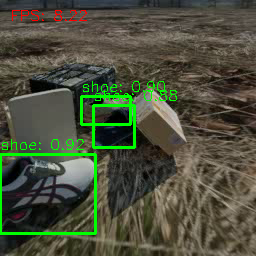


0: 640x640 3 shoes, 8.2ms
Speed: 2.6ms preprocess, 8.2ms inference, 1.4ms postprocess per image at shape (1, 3, 640, 640)
Time to process 1 frame: 17 milliseconds


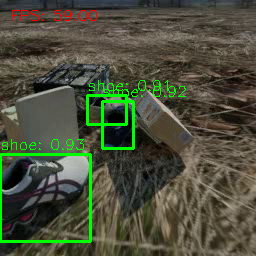


0: 640x640 3 shoes, 7.1ms
Speed: 2.0ms preprocess, 7.1ms inference, 1.3ms postprocess per image at shape (1, 3, 640, 640)
Time to process 1 frame: 15 milliseconds


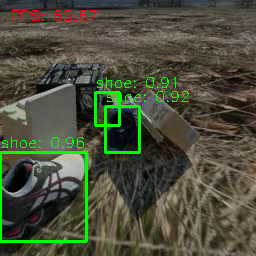


0: 640x640 3 shoes, 7.1ms
Speed: 2.0ms preprocess, 7.1ms inference, 1.3ms postprocess per image at shape (1, 3, 640, 640)
Time to process 1 frame: 15 milliseconds


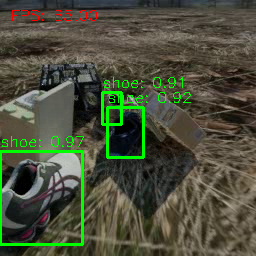


0: 640x640 3 shoes, 7.2ms
Speed: 2.1ms preprocess, 7.2ms inference, 1.4ms postprocess per image at shape (1, 3, 640, 640)
Time to process 1 frame: 16 milliseconds


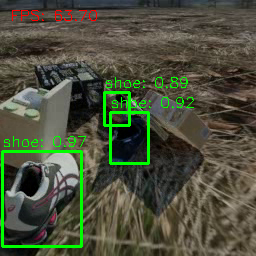


0: 640x640 3 shoes, 7.1ms
Speed: 2.1ms preprocess, 7.1ms inference, 1.5ms postprocess per image at shape (1, 3, 640, 640)
Time to process 1 frame: 16 milliseconds


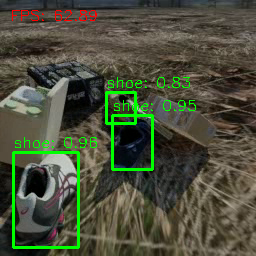


0: 640x640 3 shoes, 7.8ms
Speed: 2.2ms preprocess, 7.8ms inference, 1.5ms postprocess per image at shape (1, 3, 640, 640)
Time to process 1 frame: 17 milliseconds


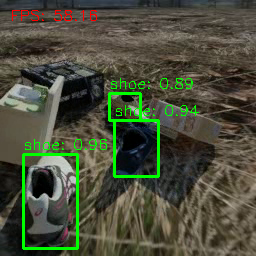


0: 640x640 2 shoes, 7.1ms
Speed: 2.4ms preprocess, 7.1ms inference, 1.4ms postprocess per image at shape (1, 3, 640, 640)
Time to process 1 frame: 16 milliseconds


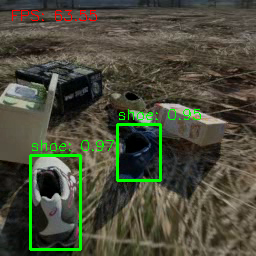


0: 640x640 3 shoes, 7.5ms
Speed: 2.1ms preprocess, 7.5ms inference, 1.3ms postprocess per image at shape (1, 3, 640, 640)
Time to process 1 frame: 15 milliseconds


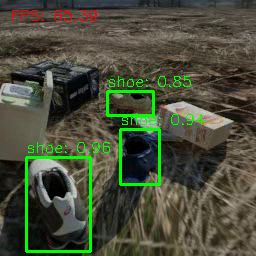


0: 640x640 3 shoes, 7.3ms
Speed: 2.1ms preprocess, 7.3ms inference, 1.6ms postprocess per image at shape (1, 3, 640, 640)
Time to process 1 frame: 16 milliseconds


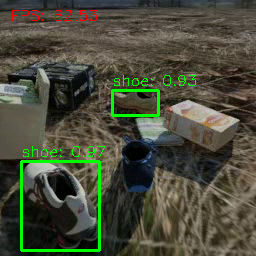


0: 640x640 3 shoes, 9.3ms
Speed: 2.8ms preprocess, 9.3ms inference, 1.7ms postprocess per image at shape (1, 3, 640, 640)
Time to process 1 frame: 19 milliseconds


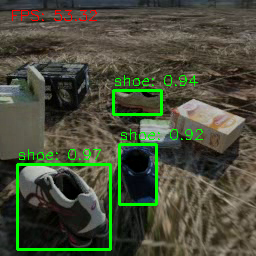


0: 640x640 3 shoes, 7.1ms
Speed: 2.0ms preprocess, 7.1ms inference, 1.5ms postprocess per image at shape (1, 3, 640, 640)
Time to process 1 frame: 15 milliseconds


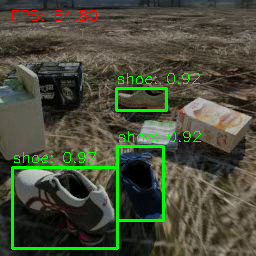


0: 640x640 3 shoes, 7.1ms
Speed: 1.9ms preprocess, 7.1ms inference, 1.3ms postprocess per image at shape (1, 3, 640, 640)
Time to process 1 frame: 15 milliseconds


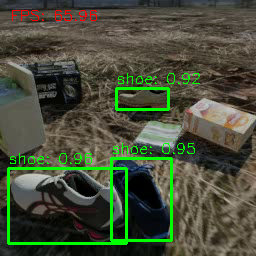


0: 640x640 3 shoes, 7.2ms
Speed: 2.1ms preprocess, 7.2ms inference, 1.3ms postprocess per image at shape (1, 3, 640, 640)
Time to process 1 frame: 15 milliseconds


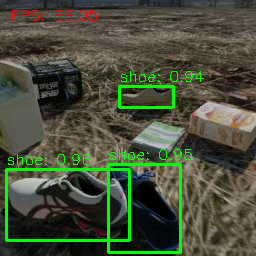


0: 640x640 3 shoes, 7.1ms
Speed: 2.1ms preprocess, 7.1ms inference, 1.3ms postprocess per image at shape (1, 3, 640, 640)
Time to process 1 frame: 15 milliseconds


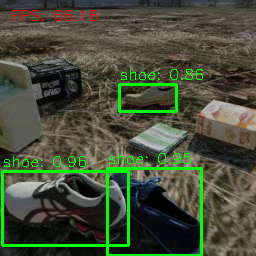


0: 640x640 3 shoes, 7.3ms
Speed: 2.1ms preprocess, 7.3ms inference, 1.4ms postprocess per image at shape (1, 3, 640, 640)
Time to process 1 frame: 15 milliseconds


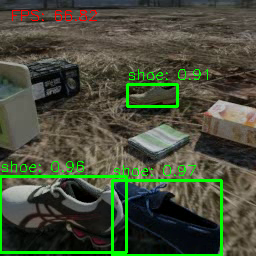


0: 640x640 3 shoes, 7.3ms
Speed: 2.0ms preprocess, 7.3ms inference, 1.3ms postprocess per image at shape (1, 3, 640, 640)
Time to process 1 frame: 15 milliseconds


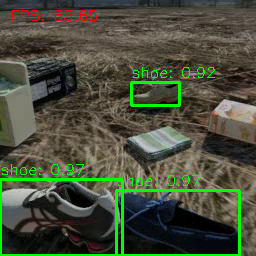


0: 640x640 3 shoes, 8.2ms
Speed: 2.0ms preprocess, 8.2ms inference, 1.5ms postprocess per image at shape (1, 3, 640, 640)
Time to process 1 frame: 16 milliseconds


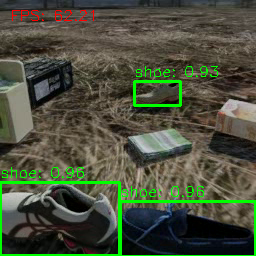


0: 640x640 3 shoes, 7.4ms
Speed: 2.0ms preprocess, 7.4ms inference, 1.3ms postprocess per image at shape (1, 3, 640, 640)
Time to process 1 frame: 15 milliseconds


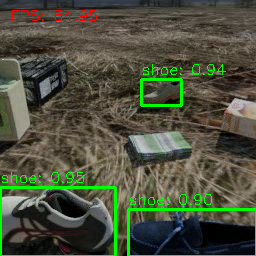


0: 640x640 3 shoes, 7.2ms
Speed: 2.6ms preprocess, 7.2ms inference, 1.5ms postprocess per image at shape (1, 3, 640, 640)
Time to process 1 frame: 16 milliseconds


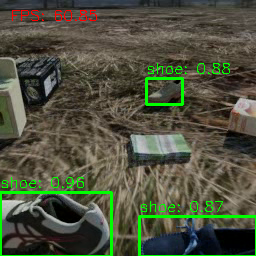


0: 640x640 3 shoes, 7.3ms
Speed: 2.0ms preprocess, 7.3ms inference, 1.3ms postprocess per image at shape (1, 3, 640, 640)
Time to process 1 frame: 16 milliseconds


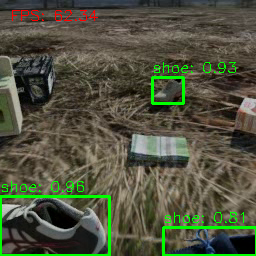


0: 640x640 3 shoes, 7.6ms
Speed: 2.5ms preprocess, 7.6ms inference, 1.5ms postprocess per image at shape (1, 3, 640, 640)
Time to process 1 frame: 18 milliseconds


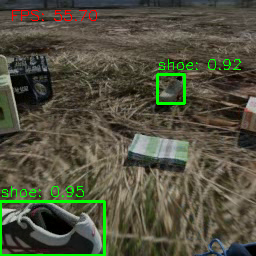


0: 640x640 2 shoes, 7.6ms
Speed: 2.9ms preprocess, 7.6ms inference, 1.4ms postprocess per image at shape (1, 3, 640, 640)
Time to process 1 frame: 17 milliseconds


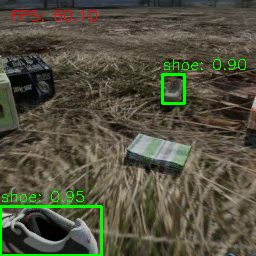


0: 640x640 2 shoes, 7.4ms
Speed: 2.7ms preprocess, 7.4ms inference, 1.4ms postprocess per image at shape (1, 3, 640, 640)
Time to process 1 frame: 17 milliseconds


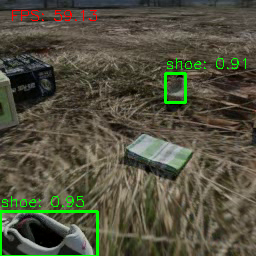

In [ ]:
import datetime
from ultralytics import YOLO
import cv2
from google.colab.patches import cv2_imshow

# Define some constants
CONFIDENCE_THRESHOLD = 0.8
GREEN = (0, 255, 0)

# Initialize the video capture object
video_cap = cv2.VideoCapture("/content/drive/MyDrive/CV/output_videos/video_10.mp4")

# Load the pre-trained YOLOv8n model
model = YOLO("/content/drive/MyDrive/runs/detect/train/weights/best.pt")

# Define the output video file path
output_video_path = "/content/output_video.avi"
fourcc = cv2.VideoWriter_fourcc(*"DIVX")
output_video = cv2.VideoWriter(output_video_path, fourcc, 20.0, (int(video_cap.get(3)), int(video_cap.get(4))))

while True:
    # Start time to compute the fps
    start = datetime.datetime.now()

    ret, frame = video_cap.read()

    # If there are no more frames to process, break out of the loop
    if not ret:
        break
    frame = cv2.resize(frame, (256, 256))

    # Run the YOLO model on the frame
    detections = model(frame)[0]

    # Loop over the detections
    for data in detections.boxes.data.tolist():
        # Extract the confidence (i.e., probability) associated with the detection
        confidence = data[4]

        # Filter out weak detections by ensuring the
        # confidence is greater than the minimum confidence
        if float(confidence) < CONFIDENCE_THRESHOLD:
            continue

        # Extract class and confidence score
        class_index = int(data[5])
        class_name = model.names[class_index]
        display_text = f"{class_name}: {confidence:.2f}"

        # If the confidence is greater than the minimum confidence,
        # draw the bounding box on the frame and display class and confidence
        xmin, ymin, xmax, ymax = map(int, data[:4])
        cv2.rectangle(frame, (xmin, ymin), (xmax, ymax), GREEN, 2)
        cv2.putText(frame, display_text, (xmin, ymin - 5), cv2.FONT_HERSHEY_SIMPLEX, 0.5, GREEN, 1)

    # End time to compute the fps
    end = datetime.datetime.now()
    # Show the time it took to process 1 frame
    total = (end - start).total_seconds()
    print(f"Time to process 1 frame: {total * 1000:.0f} milliseconds")

    # Calculate the frame per second and draw it on the frame
    fps = f"FPS: {1 / total:.2f}"
    cv2.putText(frame, fps, (10, 20), cv2.FONT_HERSHEY_SIMPLEX, 0.5, (0, 0, 255), 1)

    # Show the frame to our screen
    cv2_imshow(frame)

    # Write the frame to the output video
    output_video.write(frame)

    # Break the loop if the user presses 'q'
    if cv2.waitKey(1) == ord("q"):
        break

# Release the video capture and writer
video_cap.release()
output_video.release()
cv2.destroyAllWindows()


## 4.Modelling Object Tracking

### 4.1.Convert and Display Video

In [ ]:
!ffmpeg -i /content/drive/MyDrive/CV/output_video.avi -vf fps=30 -vcodec libx264 /content/drive/MyDrive/CV/output_video.mp4

ffmpeg version 4.4.2-0ubuntu0.22.04.1 Copyright (c) 2000-2021 the FFmpeg developers
  built with gcc 11 (Ubuntu 11.2.0-19ubuntu1)
  configuration: --prefix=/usr --extra-version=0ubuntu0.22.04.1 --toolchain=hardened --libdir=/usr/lib/x86_64-linux-gnu --incdir=/usr/include/x86_64-linux-gnu --arch=amd64 --enable-gpl --disable-stripping --enable-gnutls --enable-ladspa --enable-libaom --enable-libass --enable-libbluray --enable-libbs2b --enable-libcaca --enable-libcdio --enable-libcodec2 --enable-libdav1d --enable-libflite --enable-libfontconfig --enable-libfreetype --enable-libfribidi --enable-libgme --enable-libgsm --enable-libjack --enable-libmp3lame --enable-libmysofa --enable-libopenjpeg --enable-libopenmpt --enable-libopus --enable-libpulse --enable-librabbitmq --enable-librubberband --enable-libshine --enable-libsnappy --enable-libsoxr --enable-libspeex --enable-libsrt --enable-libssh --enable-libtheora --enable-libtwolame --enable-libvidstab --enable-libvorbis --enable-libvpx --enab

In [ ]:
from IPython.display import HTML
from base64 import b64encode
mp4 = open('/content/track/output_video.mp4','rb').read()
data_url = "data:video/mp4;base64," + b64encode(mp4).decode()
HTML("""
<video controls autoplay>
      <source src="%s" type="video/mp4">
</video>
""" % data_url)

### 4.2.Visualizing Deep SORT Real-time Tracking Results

Install deep_sort_realtime

In [ ]:
!pip install deep_sort_realtime


     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 8.4/8.4 MB 45.7 MB/s eta 0:00:00


#### Display Images Using Matplotlib

In [ ]:
import cv2
import matplotlib.pyplot as plt

imgp="/content/runs/detect/train2/results.png"
img = cv2.imread(imgp)
img = cv2.cvtColor(img, cv2.COLOR_BGRA2RGB)
fig, ax = plt.subplots(figsize=(10, 10))
ax.imshow(img)
ax.axis('off')
plt.show()

In [ ]:
import cv2
import matplotlib.pyplot as plt

imgp="/content/runs/detect/val/R_curve.png"
img = cv2.imread(imgp)
img = cv2.cvtColor(img, cv2.COLOR_BGRA2RGB)
fig, ax = plt.subplots(figsize=(10, 10))
ax.imshow(img)
ax.axis('off')
plt.show()

In [ ]:
import cv2
import matplotlib.pyplot as plt

imgp="/content/runs/detect/val/P_curve.png"
img = cv2.imread(imgp)
img = cv2.cvtColor(img, cv2.COLOR_BGRA2RGB)
fig, ax = plt.subplots(figsize=(10, 10))
ax.imshow(img)
ax.axis('off')
plt.show()

In [ ]:
import cv2
import matplotlib.pyplot as plt

imgp="/content/runs/detect/val/F1_curve.png"
img = cv2.imread(imgp)
img = cv2.cvtColor(img, cv2.COLOR_BGRA2RGB)
fig, ax = plt.subplots(figsize=(10, 10))
ax.imshow(img)
ax.axis('off')
plt.show()

### 4.3.Evaluation Metrics for Bounding Boxes

#### Here we make:
1. Intersection over Union (IoU) Calculation
2. Average Mean Squared Error (MSE) Calculation
3. Handling Different Cases
4. Frame Evaluation
5. Transformation of Bounding Boxes

In [ ]:

def calculate_iou(boxA, boxB):
    # Calculate the intersection coordinates
    xA = max(boxA[0] - boxA[2] / 2, boxB[0] - boxB[2] / 2)
    yA = max(boxA[1] - boxA[3] / 2, boxB[1] - boxB[3] / 2)
    xB = min(boxA[0] + boxA[2] / 2, boxB[0] + boxB[2] / 2)
    yB = min(boxA[1] + boxA[3] / 2, boxB[1] + boxB[3] / 2)

    # Calculate the area of intersection rectangle
    intersection_area = max(0, xB - xA) * max(0, yB - yA)

    # Calculate the area of both the ground truth and predicted bounding boxes
    boxA_area = boxA[2] * boxA[3]
    boxB_area = boxB[2] * boxB[3]

    # Calculate the Union area
    union_area = boxA_area + boxB_area - intersection_area

    # Calculate Intersection over Union
    iou = intersection_area / union_area if union_area > 0 else 0
    return iou

def calculate_avg_mse(ground_truth_bboxes, predicted_bboxes):
    mse_values = []

    for gt_box, pred_box in zip(ground_truth_bboxes, predicted_bboxes):
        mse = ((gt_box[0] - pred_box[0]) ** 2 + (gt_box[1] - pred_box[1]) ** 2)
        mse_values.append(mse)

    avg_mse = sum(mse_values) / len(ground_truth_bboxes)
    return avg_mse
def case_both_empty(ground_truth_bboxes, predicted_bboxes):
    if not ground_truth_bboxes and not predicted_bboxes:
        return 100
    return 0
def case_no_ground_truth(ground_truth_bboxes, predicted_bboxes):
    if not ground_truth_bboxes:
        return 0
    return 0
def case_no_predicted(ground_truth_bboxes, predicted_bboxes):
    if not predicted_bboxes:
        return 0
    return 0
def case_gt_is_higher(ground_truth_bboxes, predicted_bboxes):
    best_iou = 0

    if not ground_truth_bboxes or not predicted_bboxes:
        return 0, calculate_avg_mse(ground_truth_bboxes, predicted_bboxes)

    num_predicted = len(predicted_bboxes)
    num_ground_truth = len(ground_truth_bboxes)

    best_iou_sum = 0
    best_iou_count = 0
    iou_list = []
    for pbox in predicted_bboxes:
      for gbox in ground_truth_bboxes:

        tempIOU = calculate_iou(pbox, gbox)
        if tempIOU > best_iou:
          best_iou = tempIOU

      iou_list.append(best_iou)

    return sum(iou_list) /num_ground_truth

def case_predicted_is_higher(ground_truth_bboxes, predicted_bboxes):
    best_iou = 0

    if len(ground_truth_bboxes) == 0 or len(predicted_bboxes) == 0:
        return 0, calculate_avg_mse(ground_truth_bboxes, predicted_bboxes)

    num_predicted = len(predicted_bboxes)
    num_ground_truth = len(ground_truth_bboxes)

    best_iou_sum = 0
    best_iou_count = 0
    iou_list = []

    for gbox in ground_truth_bboxes:
        for pbox in predicted_bboxes:
            tempIOU = calculate_iou(pbox, gbox)
            if tempIOU > best_iou:
                best_iou = tempIOU
        iou_list.append(best_iou)

    return sum(iou_list) / num_predicted

def case_same_num_boxes(ground_truth_bboxes, predicted_bboxes):
    best_iou = 0

    if len(ground_truth_bboxes) == 0 or len(predicted_bboxes) == 0:
        return 0, calculate_avg_mse(ground_truth_bboxes, predicted_bboxes)

    num_predicted = len(predicted_bboxes)
    num_ground_truth = len(ground_truth_bboxes)

    best_iou_sum = 0
    best_iou_count = 0
    iou_list = []

    for gbox in ground_truth_bboxes:
        for pbox in predicted_bboxes:
            tempIOU = calculate_iou(pbox, gbox)
            if tempIOU > best_iou:
                best_iou = tempIOU
        iou_list.append(best_iou)

    return sum(iou_list) / num_ground_truth

def frame_evaluate(ground_truth_bboxes, predicted_bboxes):
    if len(ground_truth_bboxes) == 0 and len(predicted_bboxes) == 0:
        return case_both_empty(ground_truth_bboxes, predicted_bboxes)
    elif len(ground_truth_bboxes) == 0:
        return case_no_ground_truth(ground_truth_bboxes, predicted_bboxes)
    elif len(predicted_bboxes) == 0:
        return case_no_predicted(ground_truth_bboxes, predicted_bboxes)
    elif len(ground_truth_bboxes) > len(predicted_bboxes):
        return case_gt_is_higher(ground_truth_bboxes, predicted_bboxes)
    elif len(ground_truth_bboxes) < len(predicted_bboxes):
        return case_predicted_is_higher(ground_truth_bboxes, predicted_bboxes)
    else:
        return case_same_num_boxes(ground_truth_bboxes, predicted_bboxes)

# `apply_bbox_to_y_valid` processes a multi-dimensional list y_valid containing bounding box data. It systematically traverses each row within this list, manipulating each bounding box individually. For every bounding box encountered in a row, the function removes the last value, assuming it represents an undesired element. Subsequently, it applies a transformation through the bbox function to compute the center coordinates, width, and height of the modified bounding box. The resulting altered bounding box data for each row is then stored within modified_y_valid, producing a new list that contains transformed bounding boxes corresponding to each row in the original y_valid.
def apply_bbox_to_y_valid(y_valid):
    # Create an empty list to store the modified bounding boxes
    modified_y_valid = []

    # Iterate through each row in y_valid
    for row in y_valid:
        modified_row = []

        # Iterate through each bounding box in the current row
        for bbox_data in row:
            # Drop the last value from the bounding box data
            bbox_data_trimmed = bbox_data[:-1]

            # Apply the bbox function to the modified bounding box data
            modified_bbox = bbox(*bbox_data_trimmed)
            modified_row.append(modified_bbox)

        modified_y_valid.append(modified_row)

    return modified_y_valid

# y_valid_xywh = pd.Series(apply_bbox_to_y_valid(y_valid))

## 5.Modelling

### 5.1.Tracking Evaluation and Visualization

In this code we make:
1. DeepSORT Tracker Initialization
2. Object Detection and Tracking Loop
3. Evaluate Tracking Performance
4. Visualization of Tracked Objects


0: 256x256 3 shoes, 7.1ms
Speed: 0.3ms preprocess, 7.1ms inference, 1.8ms postprocess per image at shape (1, 3, 256, 256)


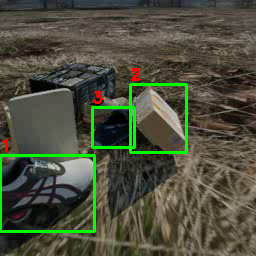


0: 256x256 2 shoes, 8.8ms
Speed: 0.4ms preprocess, 8.8ms inference, 2.0ms postprocess per image at shape (1, 3, 256, 256)


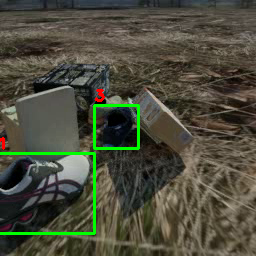


0: 256x256 2 shoes, 8.7ms
Speed: 0.4ms preprocess, 8.7ms inference, 1.9ms postprocess per image at shape (1, 3, 256, 256)


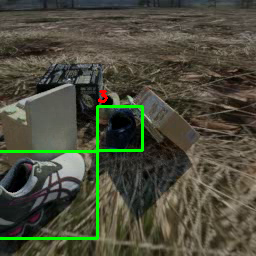


0: 256x256 2 shoes, 8.6ms
Speed: 0.3ms preprocess, 8.6ms inference, 2.2ms postprocess per image at shape (1, 3, 256, 256)


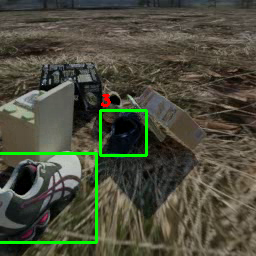


0: 256x256 3 shoes, 8.6ms
Speed: 0.3ms preprocess, 8.6ms inference, 2.0ms postprocess per image at shape (1, 3, 256, 256)


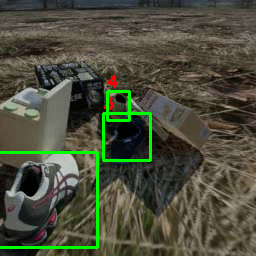


0: 256x256 3 shoes, 9.1ms
Speed: 0.4ms preprocess, 9.1ms inference, 2.0ms postprocess per image at shape (1, 3, 256, 256)


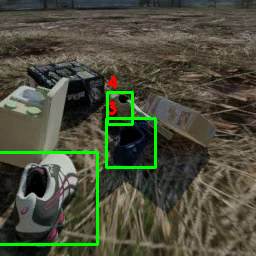


0: 256x256 2 shoes, 8.6ms
Speed: 0.4ms preprocess, 8.6ms inference, 2.1ms postprocess per image at shape (1, 3, 256, 256)


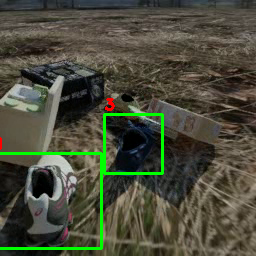


0: 256x256 2 shoes, 10.2ms
Speed: 0.4ms preprocess, 10.2ms inference, 1.9ms postprocess per image at shape (1, 3, 256, 256)


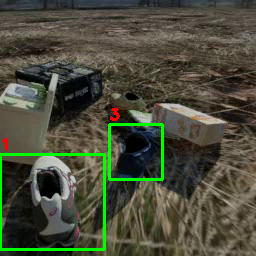


0: 256x256 2 shoes, 9.5ms
Speed: 0.4ms preprocess, 9.5ms inference, 2.0ms postprocess per image at shape (1, 3, 256, 256)


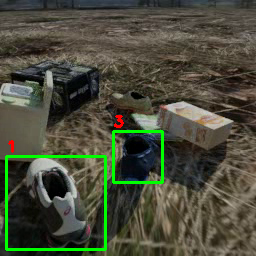


0: 256x256 2 shoes, 8.2ms
Speed: 0.3ms preprocess, 8.2ms inference, 1.8ms postprocess per image at shape (1, 3, 256, 256)


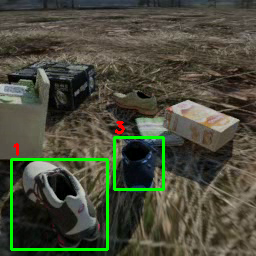


0: 256x256 2 shoes, 8.0ms
Speed: 0.4ms preprocess, 8.0ms inference, 1.7ms postprocess per image at shape (1, 3, 256, 256)


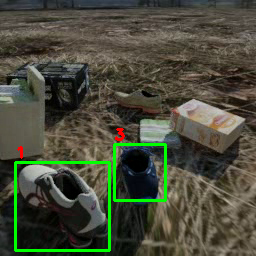


0: 256x256 2 shoes, 9.1ms
Speed: 0.4ms preprocess, 9.1ms inference, 1.9ms postprocess per image at shape (1, 3, 256, 256)


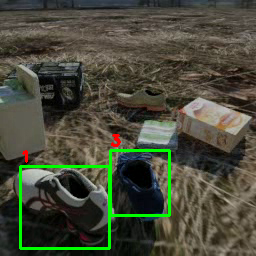


0: 256x256 2 shoes, 8.8ms
Speed: 0.4ms preprocess, 8.8ms inference, 1.7ms postprocess per image at shape (1, 3, 256, 256)


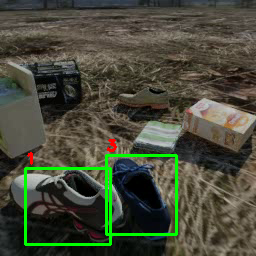


0: 256x256 2 shoes, 10.0ms
Speed: 0.4ms preprocess, 10.0ms inference, 1.8ms postprocess per image at shape (1, 3, 256, 256)


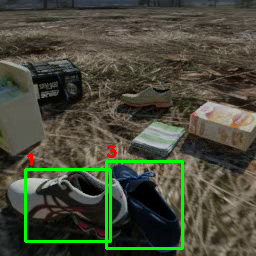


0: 256x256 2 shoes, 11.0ms
Speed: 0.4ms preprocess, 11.0ms inference, 2.3ms postprocess per image at shape (1, 3, 256, 256)


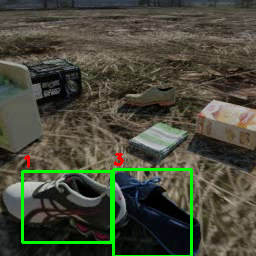


0: 256x256 2 shoes, 9.2ms
Speed: 1.1ms preprocess, 9.2ms inference, 1.8ms postprocess per image at shape (1, 3, 256, 256)


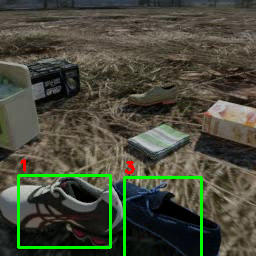


0: 256x256 2 shoes, 8.0ms
Speed: 0.4ms preprocess, 8.0ms inference, 1.6ms postprocess per image at shape (1, 3, 256, 256)


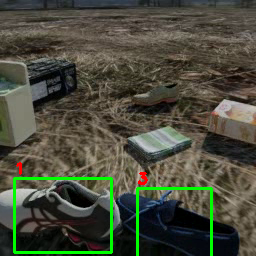


0: 256x256 2 shoes, 9.0ms
Speed: 0.4ms preprocess, 9.0ms inference, 1.9ms postprocess per image at shape (1, 3, 256, 256)


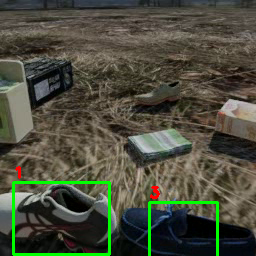


0: 256x256 2 shoes, 7.6ms
Speed: 0.4ms preprocess, 7.6ms inference, 1.5ms postprocess per image at shape (1, 3, 256, 256)


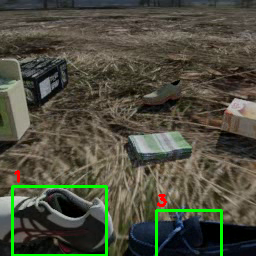


0: 256x256 2 shoes, 8.1ms
Speed: 0.3ms preprocess, 8.1ms inference, 1.6ms postprocess per image at shape (1, 3, 256, 256)


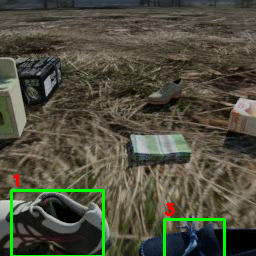


0: 256x256 1 shoe, 9.0ms
Speed: 0.4ms preprocess, 9.0ms inference, 2.0ms postprocess per image at shape (1, 3, 256, 256)


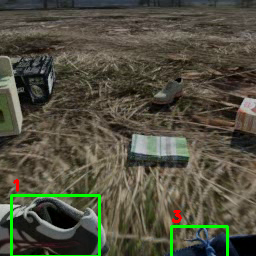


0: 256x256 1 shoe, 9.3ms
Speed: 0.4ms preprocess, 9.3ms inference, 7.6ms postprocess per image at shape (1, 3, 256, 256)


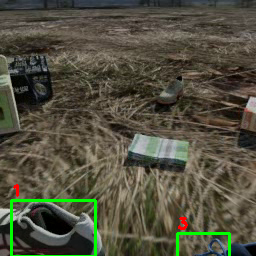


0: 256x256 1 shoe, 9.3ms
Speed: 0.4ms preprocess, 9.3ms inference, 2.1ms postprocess per image at shape (1, 3, 256, 256)


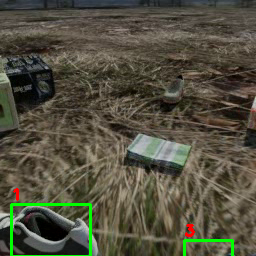


0: 256x256 1 shoe, 23.3ms
Speed: 0.4ms preprocess, 23.3ms inference, 2.7ms postprocess per image at shape (1, 3, 256, 256)


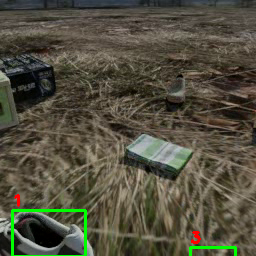

Average IoU for frame: 1.0000000079301459
Average IoU for frame: 0.9394656688232352
Average IoU for frame: 0.8663059081531368
Average IoU for frame: 0.8359535784651431
Average IoU for frame: 0.869574824744448
Average IoU for frame: 0.810968844283078
Average IoU for frame: 0.7024556702867453
Average IoU for frame: 0.6839389963987415
Average IoU for frame: 0.7894800554833874
Average IoU for frame: 0.8610479364399328
Average IoU for frame: 0.9692750956735308
Average IoU for frame: 0.9174141568538838
Average IoU for frame: 0.8421201767591411
Average IoU for frame: 0.8255829694816104
Average IoU for frame: 0.8115152169177464
Average IoU for frame: 0.7953507425114602
Average IoU for frame: 0.7918925456446304
Average IoU for frame: 0.7910641211982385
Average IoU for frame: 0.8060226034470785
Average IoU for frame: 0.8039640771662592
Average IoU for frame: 0.4011667033853878
Average IoU for frame: 0.39721794956883255
Average IoU for frame: 0.3929292558490723
Average IoU for frame: 0.3797095351

In [ ]:
import os
import cv2
import torch
import numpy as np
from google.colab.patches import cv2_imshow
from ultralytics import YOLO
from deep_sort_realtime.deepsort_tracker import DeepSort

video_cap = cv2.VideoCapture("/content/drive/MyDrive/CV/output_videos/video_10.mp4")

# Load the pre-trained YOLOv8n model
model = YOLO("/content/drive/MyDrive/runs/detect/train/weights/best.pt")

# Define the output video file path
output_video_path = "/content/output_video_with_tracking.avi"
fourcc = cv2.VideoWriter_fourcc(*"DIVX")
output_video = cv2.VideoWriter(output_video_path, fourcc, 20.0, (int(video_cap.get(3)), int(video_cap.get(4))))
gt_bboxes_list = []
predicted_bboxes_list = []
# Initialize the DeepSORT tracker
tracker = DeepSort(max_iou_distance=0.8)

# Loop over each frame in the video
while True:
    # Read the next frame from the video
    ret, frame = video_cap.read()

    # Check if the end of the video has been reached
    if not ret:
        break

    # Convert the frame to RGB format
    frame_rgb = cv2.cvtColor(frame, cv2.COLOR_BGR2RGB)

    # Normalize pixel values to the range [0, 1]
    frame_normalized = frame_rgb / 255.0

    # Convert the frame to a PyTorch tensor
    frame_tensor = torch.from_numpy(frame_normalized).permute(2, 0, 1).unsqueeze(0).float()

    # Detect objects in the frame
    results = model(frame_tensor)

    # Extract bounding boxes from results
    boxes = results[0].boxes.xyxy.cpu().numpy()
    # ground_truth_bboxes = [...]
    # Track the objects in the frame only if there are detections
    if len(boxes) > 0:
        detections = []
        for r, s, c in zip(boxes, results[0].boxes.conf.cpu().numpy(), results[0].boxes.cls.cpu().numpy()):
            x1, y1, x2, y2 = r
            score = float(s)
            class_id = int(c)
            x1, y1, x2, y2 = map(float, [x1, y1, x2, y2])

            # if score > 0.89:
            detections.append([[x1, y1, x2 - x1, y2 - y1], score, class_id])

        # Track the objects in the frame
        tracks = tracker.update_tracks(detections, frame=frame)
        predicted_bboxes = []

        # Draw the bounding boxes and track IDs on the frame
        for track in tracks:
            # Extract the bounding box coordinates and track ID
            x, y, w, h = track.to_tlwh()

            # Convert the bounding box coordinates to integer values
            left = int(x)
            top = int(y)
            right = int(x + w)
            bottom = int(y + h)
            predicted_bboxes.append([x, y, x + w, y + h])

            # Draw the bounding box
            cv2.rectangle(frame, (left, top), (right, bottom), (0, 255, 0), 2)

            # Draw the track ID
            cv2.putText(frame, str(track.track_id), (left, top - 5), cv2.FONT_HERSHEY_SIMPLEX, 0.5, (0, 0, 255), 2)
        gt_bboxes_list.append(boxes)
        predicted_bboxes_list.append(predicted_bboxes)

    # Write the frame with tracking information to the output video
    output_video.write(frame)

    # Display the frame
    cv2_imshow(frame)

    # Check if the user wants to quit the program
    if cv2.waitKey(1) & 0xFF == ord("q"):
        break

# Release the video capture and writer
video_cap.release()
output_video.release()

# Close all windows
cv2.destroyAllWindows()
# Evaluate tracking performance using the provided metrics
for gt_bboxes, pred_bboxes in zip(gt_bboxes_list, predicted_bboxes_list):
    avg_iou = frame_evaluate(gt_bboxes, pred_bboxes)
    print(f"Average IoU for frame: {avg_iou}")


### 5.2. Calculate the mean IoU using numpy

Mean Average IoU = 76.125% indicates the mean average Intersection over Union (IoU) across multiple frames or instances in a computer vision

In [ ]:
# Calculate the mean using numpy
mean_iou = np.mean(avg_iou_values)

# Print the mean
print(f"Mean Average IoU: {mean_iou}")

Mean Average IoU: 0.7612500000000001


### 5.3.Calculating Average IoU and Creating DataFrame

In [ ]:
import pandas as pd

# Assuming avg_iou_values is a list of your Average IoU values
avg_iou_values = [1.0, 0.93, 0.87, 0.84, 0.86, 0.81, 0.70, 0.68, 0.79, 0.86, 0.97, 0.92, 0.84, 0.83, 0.81, 0.80, 0.79, 0.79, 0.81, 0.80, 0.40, 0.40, 0.39, 0.38]

# Create a DataFrame
df = pd.DataFrame({"Average IoU": avg_iou_values})

# Copy the DataFrame to the clipboard
df.to_csv(index=False)


'Average IoU\n1.0\n0.93\n0.87\n0.84\n0.86\n0.81\n0.7\n0.68\n0.79\n0.86\n0.97\n0.92\n0.84\n0.83\n0.81\n0.8\n0.79\n0.79\n0.81\n0.8\n0.4\n0.4\n0.39\n0.38\n'